1. EDA (Data analysis) : https://www.kaggle.com/blurredmachine/jane-street-market-eda-viz-prediction/output

2. Beginner model training (using XGBoost) : https://www.kaggle.com/wongguoxuan/eda-pca-xgboost-classifier-for-beginners

3. Extra help (using AutoEncoders) : https://www.kaggle.com/aimind/bottleneck-encoder-mlp-keras-tuner-8601c5/comments

In [2]:
import numpy as np
import pandas as pd
#pd.set_option('display.max_columns', 140)

import os
from scipy import stats

import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import plotly.graph_objs as go

# import janestreet

from sklearn.impute import SimpleImputer
from sklearn.decomposition import PCA

'''
import warnings
warnings.filterwarnings("ignore")
'''

'\nimport warnings\nwarnings.filterwarnings("ignore")\n'

In [3]:
# reading the paths of all the files present in the dataset
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/jane-street-market-prediction/example_sample_submission.csv
/kaggle/input/jane-street-market-prediction/features.csv
/kaggle/input/jane-street-market-prediction/example_test.csv
/kaggle/input/jane-street-market-prediction/train.csv
/kaggle/input/jane-street-market-prediction/janestreet/competition.cpython-37m-x86_64-linux-gnu.so
/kaggle/input/jane-street-market-prediction/janestreet/__init__.py


In [4]:
# setting the paths to variables to access when required
TRAINING_PATH = "/kaggle/input/jane-street-market-prediction/train.csv"
FEATURES_PATH = "/kaggle/input/jane-street-market-prediction/features.csv"
TEST_PATH = "/kaggle/input/jane-street-market-prediction/example_test.csv"
SAMPLE_SUB_PATH = "/kaggle/input/jane-street-market-prediction/example_sample_submission.csv"


In [6]:
%%time

s = !wc -l {TRAINING_PATH}
n_train_rows = int(s[0].split(' ')[0])+1

s = !wc -l {FEATURES_PATH}
n_features_rows = int(s[0].split(' ')[0])+1

s = !wc -l {TEST_PATH}
n_test_rows = int(s[0].split(' ')[0])+1

print('-'*30)
print (f'Total Training Rows: {n_train_rows}')
print (f'Total Features Rows: {n_features_rows}')
print (f'Total Testing Rows: {n_test_rows}')
print('-'*30)

------------------------------
Total Training Rows: 2390493
Total Features Rows: 132
Total Testing Rows: 15221
------------------------------
CPU times: user 11.6 ms, sys: 19.7 ms, total: 31.3 ms
Wall time: 43.5 s


In [11]:
s, s[0], s[0].split(' '), s[0].split(' ')[0]

(['15220 /kaggle/input/jane-street-market-prediction/example_test.csv'],
 '15220 /kaggle/input/jane-street-market-prediction/example_test.csv',
 ['15220', '/kaggle/input/jane-street-market-prediction/example_test.csv'],
 '15220')

In [18]:
!wc -l {TRAINING_PATH}

2390492 /kaggle/input/jane-street-market-prediction/train.csv


In [19]:
# reading data using pandas.

#n_rows = 300000
n_rows = 10000 #just for sample
train_df = pd.read_csv(TRAINING_PATH, nrows=n_rows)
features_df = pd.read_csv(FEATURES_PATH, nrows=n_rows)
test_df = pd.read_csv(TEST_PATH, nrows=n_rows)


In [20]:
train_df.head()

,date,weight,resp_1,resp_2,resp_3,resp_4,resp,feature_0,feature_1,feature_2,...,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,ts_id
0,0,0.000000,0.009916,0.014079,0.008773,0.001390,0.006270,1,-1.872746,-2.191242,...,NaN,1.168391,8.313583,1.782433,14.018213,2.653056,12.600292,2.301488,11.445807,0
1,0,16.673515,-0.002828,-0.003226,-0.007319,-0.011114,-0.009792,-1,-1.349537,-1.704709,...,NaN,-1.178850,1.777472,-0.915458,2.831612,-1.417010,2.297459,-1.304614,1.898684,1
2,0,0.000000,0.025134,0.027607,0.033406,0.034380,0.023970,-1,0.812780,-0.256156,...,NaN,6.115747,9.667908,5.542871,11.671595,7.281757,10.060014,6.638248,9.427299,2
3,0,0.000000,-0.004730,-0.003273,-0.000461,-0.000476,-0.003200,-1,1.174378,0.344640,...,NaN,2.838853,0.499251,3.033732,1.513488,4.397532,1.266037,3.856384,1.013469,3
4,0,0.138531,0.001252,0.002165,-0.001215,-0.006219,-0.002604,1,-3.172026,-3.093182,...,NaN,0.344850,4.101145,0.614252,6.623456,0.800129,5.233243,0.362636,3.926633,4


In [22]:
train_df.shape, test_df.shape, features_df.shape

((10000, 138), (10000, 133), (130, 30))

## Checking Datatypes

In [23]:
print("Train data set dtypes: \n")
print(f"Total Cols: {len(train_df.columns)}")
print(f"{train_df.dtypes.value_counts()}")
print('-'*30)

print("Features data set dtypes: \n")
print(f"Total Cols: {len(features_df.columns)}")
print(f"{features_df.dtypes.value_counts()}")
print('-'*30)

print("Test data set dtypes: \n")
print(f"Total Cols: {len(test_df.columns)}")
print(f"{test_df.dtypes.value_counts()}")

Train data set dtypes: 

Total Cols: 138
float64    135
int64        3
dtype: int64
------------------------------
Features data set dtypes: 

Total Cols: 30
bool      29
object     1
dtype: int64
------------------------------
Test data set dtypes: 

Total Cols: 133
float64    130
int64        3
dtype: int64


## feature-correlation : seaborn heatmap

In [24]:
correlations = train_df.corr(method='pearson')
correlations

,date,weight,resp_1,resp_2,resp_3,resp_4,resp,feature_0,feature_1,feature_2,...,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,ts_id
date,1.000000,0.038580,0.016908,0.009884,-0.017622,-0.062703,-0.061560,-0.021182,-0.053561,-0.026381,...,0.325282,0.010302,0.229563,0.026224,0.305573,0.018683,0.274801,0.012104,0.247297,0.860037
weight,0.038580,1.000000,-0.015095,-0.011738,-0.001616,-0.002294,-0.006467,0.015785,0.035499,0.084560,...,-0.019432,-0.152698,0.016461,-0.169866,-0.017324,-0.172510,-0.012034,-0.162099,0.004322,0.038070
resp_1,0.016908,-0.015095,1.000000,0.896797,0.656181,0.335854,0.387370,0.017641,0.066888,0.061979,...,0.007914,0.011856,0.007386,0.008471,0.007862,0.007912,0.005367,0.006511,0.001794,0.022618
resp_2,0.009884,-0.011738,0.896797,1.000000,0.812839,0.463837,0.527172,0.047382,0.063853,0.057187,...,0.001462,-0.000889,-0.004561,-0.004023,-0.002920,-0.003396,-0.004272,-0.005153,-0.009000,0.018508
resp_3,-0.017622,-0.001616,0.656181,0.812839,1.000000,0.778084,0.713955,0.148095,0.054440,0.046206,...,-0.008477,-0.005281,-0.010486,-0.006281,-0.007267,-0.006011,-0.007925,-0.009245,-0.014304,-0.012914
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
feature_126,0.018683,-0.172510,0.007912,-0.003396,-0.006011,-0.002428,-0.009481,-0.019036,0.373027,0.294957,...,0.270450,0.934080,0.283695,0.981102,0.353743,1.000000,0.376506,0.971351,0.333017,-0.098813
feature_127,0.274801,-0.012034,0.005367,-0.004272,-0.007925,-0.021759,-0.030211,0.014554,-0.007806,0.017880,...,0.855695,0.340557,0.840307,0.360948,0.963033,0.376506,1.000000,0.361106,0.930489,-0.030272
feature_128,0.012104,-0.162099,0.006511,-0.005153,-0.009245,-0.003379,-0.008646,-0.017023,0.365641,0.290526,...,0.234627,0.980121,0.368519,0.934357,0.313601,0.971351,0.361106,1.000000,0.397158,-0.089783
feature_129,0.247297,0.004322,0.001794,-0.009000,-0.014304,-0.024984,-0.030983,0.020095,-0.010244,0.017065,...,0.732425,0.401819,0.950013,0.293297,0.852663,0.333017,0.930489,0.397158,1.000000,-0.016430


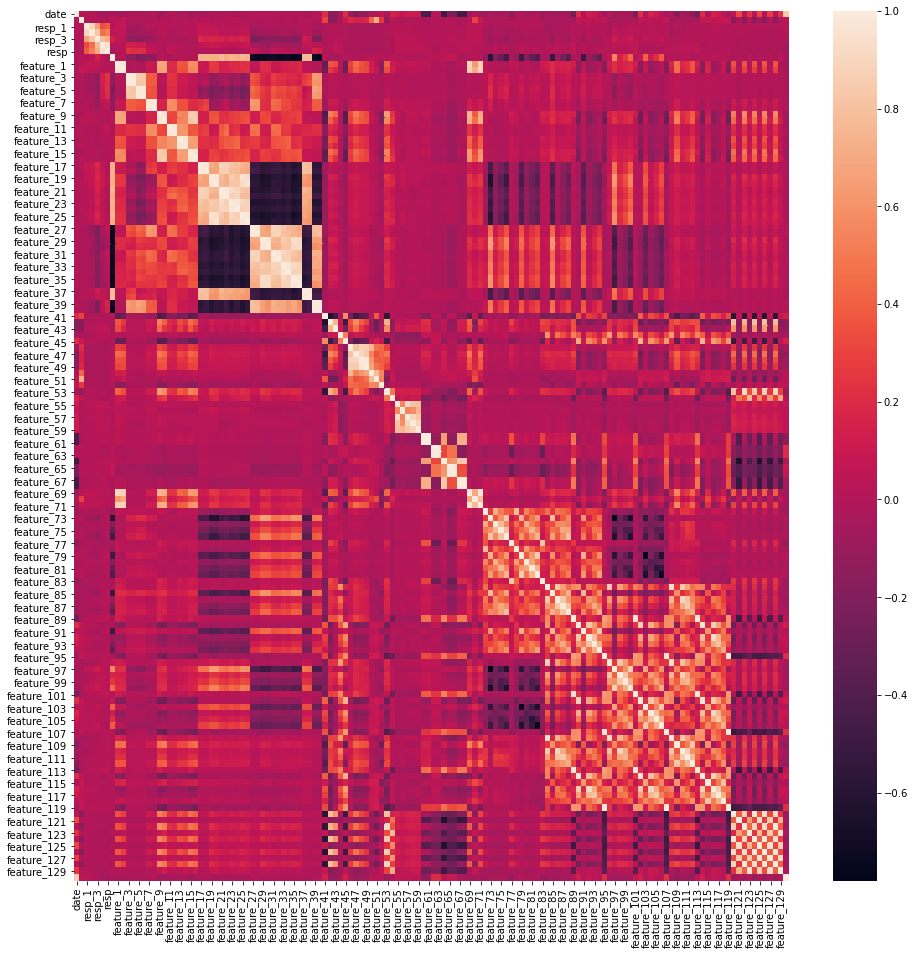

In [25]:
fig, axs = plt.subplots(figsize=(16, 16))
sns.heatmap(correlations)
fig.savefig('correlation_map.png')

## Missing values (rows and columns)

missing columns

In [35]:
# missing values column wise
train_df.isna().sum()

date            0
weight          0
resp_1          0
resp_2          0
resp_3          0
               ..
feature_126    21
feature_127    21
feature_128     4
feature_129     4
ts_id           0
Length: 138, dtype: int64

In [32]:
# total missing value : sum of missing values of all/any columns
train_df.isna().any().sum()

79

In [37]:
#  Missing Values
print('Train Nan Valued cols: {}'.format(train_df.isna().any().sum()))
print('Features Nan Valued cols: {}'.format(features_df.isna().any().sum()))
print('Test Nan Valued cols: {}'.format(test_df.isna().any().sum()))

Train Nan Valued cols: 79
Features Nan Valued cols: 0
Test Nan Valued cols: 79


missing rows

In [40]:
# checking NAN for all rows
train_df.isna().sum().sort_values(ascending=False)

feature_17    1734
feature_18    1734
feature_28    1734
feature_27    1734
feature_7     1729
              ... 
feature_53       0
feature_54       0
feature_56       0
feature_57       0
date             0
Length: 138, dtype: int64

In [41]:
# only seperate NaN rows 
nan_val = train_df.isna().sum()[train_df.isna().sum() > 0].sort_values(ascending=False)
print(nan_val)

feature_17    1734
feature_28    1734
feature_27    1734
feature_18    1734
feature_7     1729
              ... 
feature_73       2
feature_10       2
feature_9        2
feature_85       2
feature_79       2
Length: 79, dtype: int64


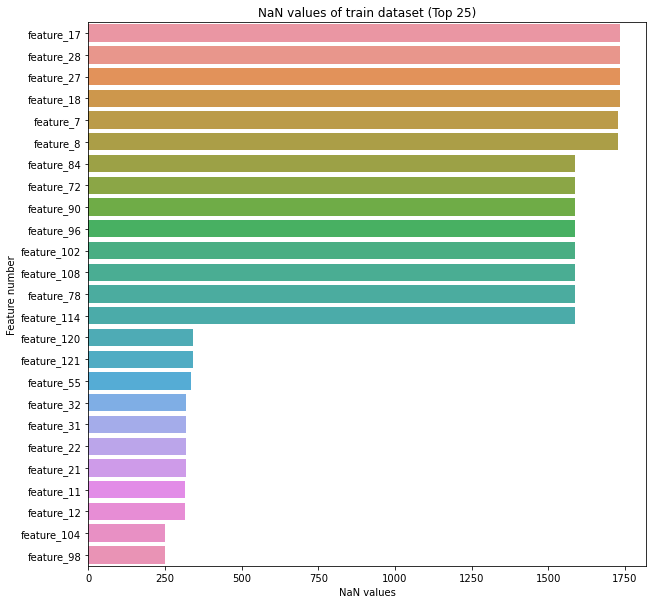

In [47]:
n_features = 25

fig, axs = plt.subplots(figsize=(10, 10))

sns.barplot(y = nan_val.index[0:n_features], 
            x = nan_val.values[0:n_features])
plt.title(f'NaN values of train dataset (Top {n_features})')
plt.xlabel('NaN values')
plt.ylabel('Feature number')
#fig.savefig(f'nan_values_top_{n_features}_features.png')
plt.show()

## Understanding distributions based using Plots

### Weight and Resp Distribution Plots

In [63]:
resp_data = train_df['resp'].values
weight_data = train_df['weight'].values

In [94]:
resp_data[:3], weight_data[:3]

(array([ 0.00627036, -0.00979168,  0.02397013]),
 array([ 0.        , 16.67351476,  0.        ]))

using MATPLOTLIB

1. Plot histogram using fig, ax
2. Plot the hist curve using sns - https://seaborn.pydata.org/generated/seaborn.kdeplot.html

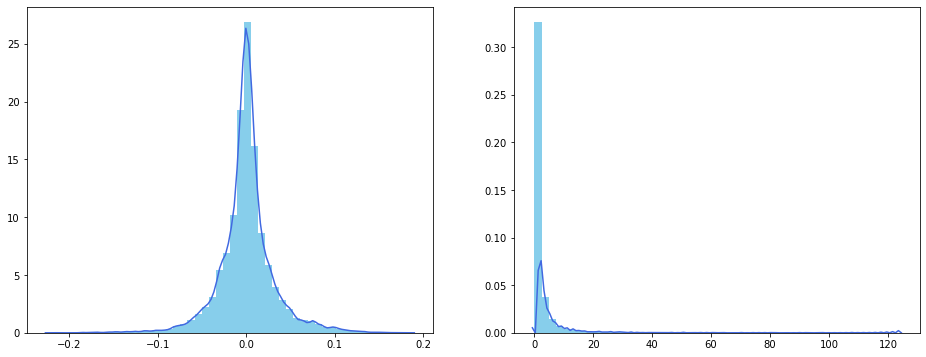

In [135]:

fig, axs = plt.subplots(1, 2, figsize=(16, 6))
axs[0].hist(resp_data, bins=50, density=1, color='skyblue')
sns.kdeplot(resp_data, ax=axs[0], color='royalblue')
axs[1].hist(weight_data, bins=50, density=1, color='skyblue')
sns.kdeplot(weight_data, ax=axs[1], color='royalblue')

plt.show()

using SEABORN

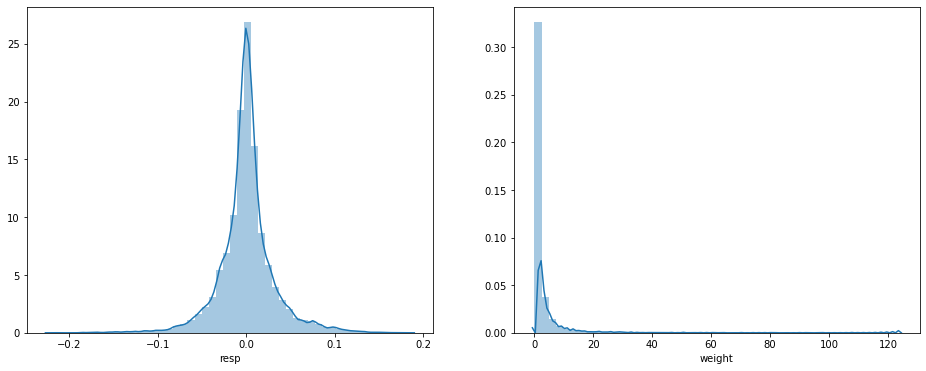

In [71]:
fig, axs = plt.subplots(1, 2, figsize=(16, 6))
sns.distplot(train_df['resp'], ax=axs[0])
sns.distplot(train_df['weight'], ax=axs[1])
plt.show()

### Resp_i distribution

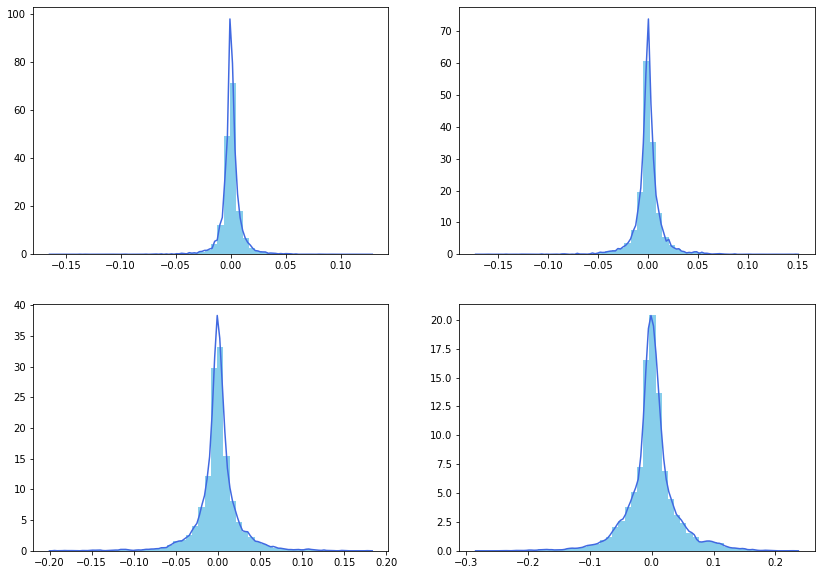

In [144]:
fig, axs = plt.subplots(2, 2, figsize=(14, 10))
axs[0][0].hist(train_df['resp_1'].values, bins=50, density=1, color='skyblue')
sns.kdeplot(train_df['resp_1'].values, ax=axs[0][0], color='royalblue')
axs[0][1].hist(train_df['resp_2'].values, bins=50, density=1, color='skyblue')
sns.kdeplot(train_df['resp_2'].values, ax=axs[0][1], color='royalblue')
axs[1][0].hist(train_df['resp_3'].values, bins=50, density=1, color='skyblue')
sns.kdeplot(train_df['resp_3'].values, ax=axs[1][0], color='royalblue')
axs[1][1].hist(train_df['resp_4'].values, bins=50, density=1, color='skyblue')
sns.kdeplot(train_df['resp_4'].values, ax=axs[1][1], color='royalblue')

plt.show()

### Feature distribution - histogram

Moving/varying histogram for each of 130 features

In [148]:
train_df['date']

0       0
1       0
2       0
3       0
4       0
       ..
9995    1
9996    1
9997    1
9998    1
9999    1
Name: date, Length: 10000, dtype: int64

In [154]:
train_df.head(5)

,date,weight,resp_1,resp_2,resp_3,resp_4,resp,feature_0,feature_1,feature_2,...,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,ts_id
0,0,0.000000,0.009916,0.014079,0.008773,0.001390,0.006270,1,-1.872746,-2.191242,...,NaN,1.168391,8.313583,1.782433,14.018213,2.653056,12.600292,2.301488,11.445807,0
1,0,16.673515,-0.002828,-0.003226,-0.007319,-0.011114,-0.009792,-1,-1.349537,-1.704709,...,NaN,-1.178850,1.777472,-0.915458,2.831612,-1.417010,2.297459,-1.304614,1.898684,1
2,0,0.000000,0.025134,0.027607,0.033406,0.034380,0.023970,-1,0.812780,-0.256156,...,NaN,6.115747,9.667908,5.542871,11.671595,7.281757,10.060014,6.638248,9.427299,2
3,0,0.000000,-0.004730,-0.003273,-0.000461,-0.000476,-0.003200,-1,1.174378,0.344640,...,NaN,2.838853,0.499251,3.033732,1.513488,4.397532,1.266037,3.856384,1.013469,3
4,0,0.138531,0.001252,0.002165,-0.001215,-0.006219,-0.002604,1,-3.172026,-3.093182,...,NaN,0.344850,4.101145,0.614252,6.623456,0.800129,5.233243,0.362636,3.926633,4


Using plotly - px to plot histogram

In [155]:
# Seeing for date = 0
date = 0
n_features = 130

cols = [f'feature_{i}' for i in range(1, n_features)]
hist = px.histogram(
    train_df[train_df["date"] == date], 
    x=cols, 
    animation_frame='variable', 
    range_y=[0, 600], 
    range_x=[-7, 7]
)

hist.show()

## Understanding Data Spread

-- dont fixate on this 

/opt/conda/lib/python3.7/site-packages/seaborn/distributions.py:37: RuntimeWarning:

invalid value encountered in double_scalars



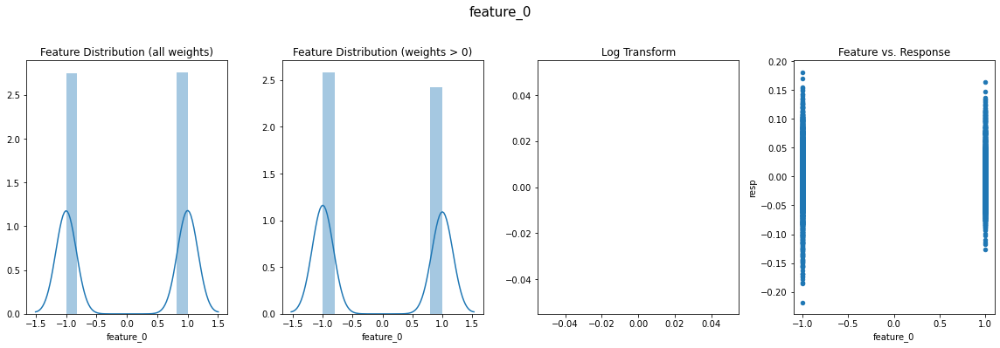

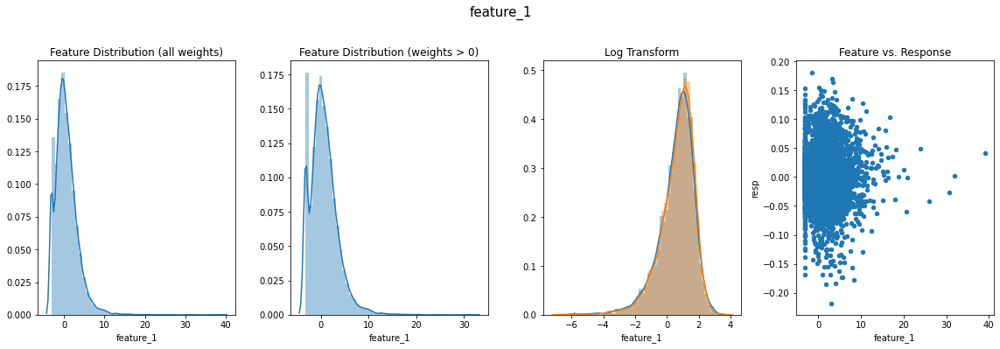

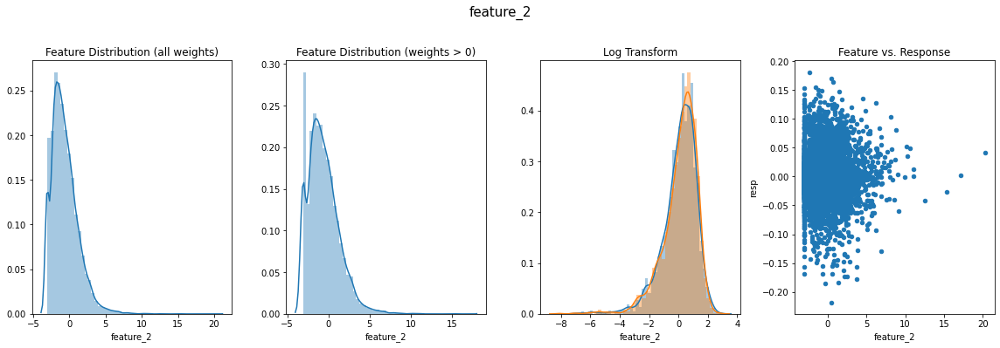

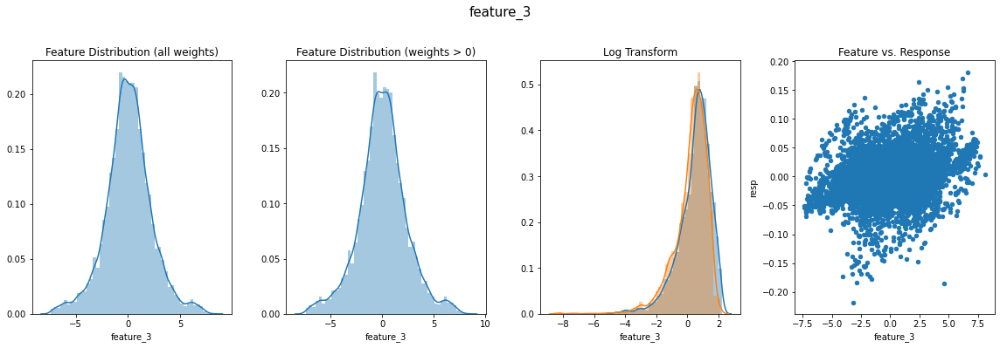

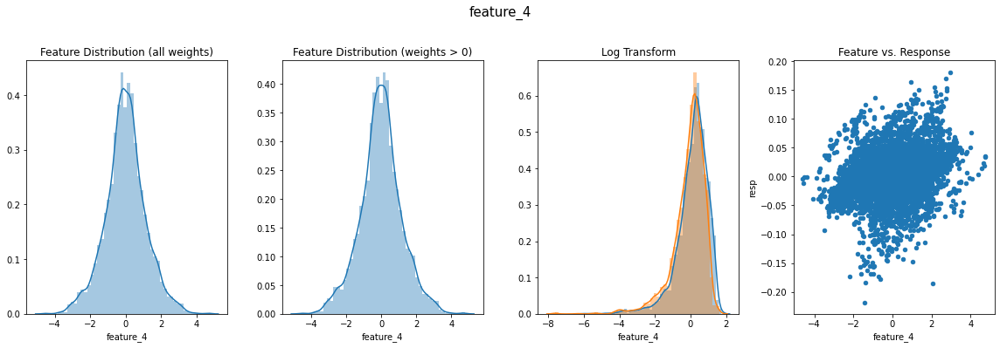

...

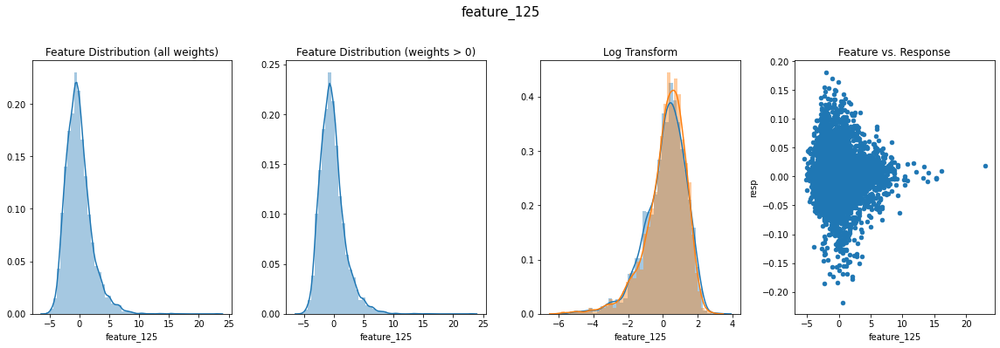

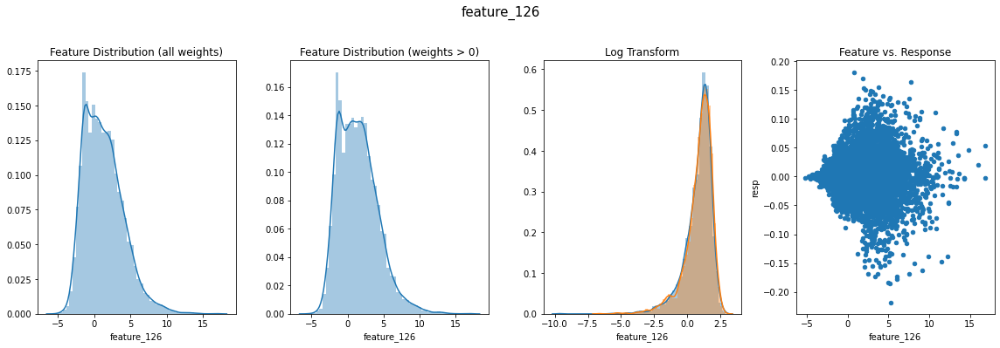

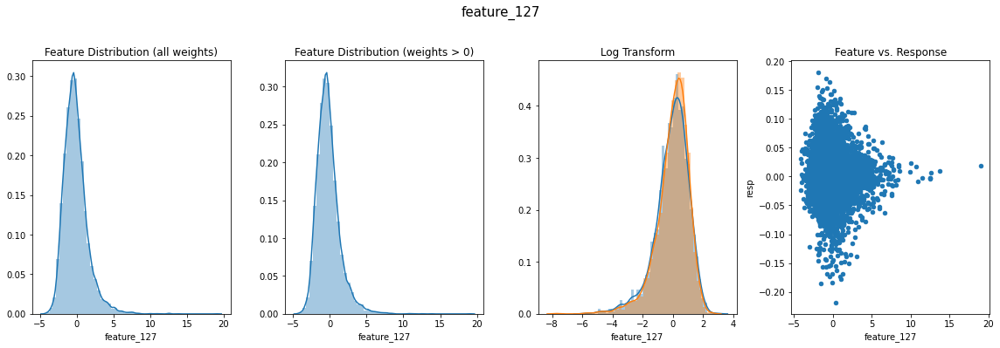

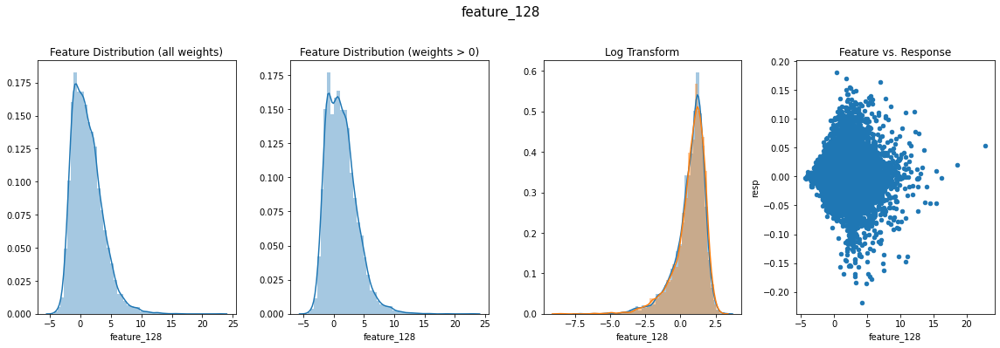

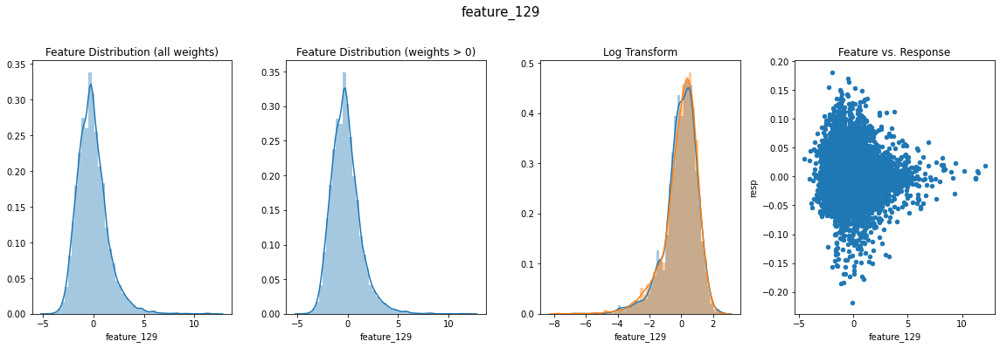

In [156]:
feature_cols = [c for c in train_df.columns if 'feature' in c]

for f in feature_cols:
    fig, axs = plt.subplots(1, 4, figsize=(16, 5))
    
    # plot 1
    sns.distplot(train_df[f], ax=axs[0])
    
    # plot 2
    sns.distplot(train_df.query('weight > 0')[f], ax=axs[1])
    
    # plot 3
    try:
        sns.distplot(train_df.query('weight > 0 and resp > 0')[f].dropna().apply(np.log1p), ax=axs[2])
        sns.distplot(train_df.query('weight > 0 and resp < 0')[f].dropna().apply(np.log1p), ax=axs[2])
    except:
        pass
    
    # plot 4
    train_df.plot(kind='scatter', x=f, y='resp', ax=axs[3])
    
    fig.suptitle(f, fontsize=15, y=1.1)
    axs[0].set_title('Feature Distribution (all weights)')
    axs[1].set_title('Feature Distribution (weights > 0)')
    axs[2].set_title('Log Transform')
    axs[3].set_title('Feature vs. Response')
    
    plt.tight_layout()
    plt.show()

## a) Imputing missing data

In [157]:
train_df.head()

,date,weight,resp_1,resp_2,resp_3,resp_4,resp,feature_0,feature_1,feature_2,...,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,ts_id
0,0,0.000000,0.009916,0.014079,0.008773,0.001390,0.006270,1,-1.872746,-2.191242,...,NaN,1.168391,8.313583,1.782433,14.018213,2.653056,12.600292,2.301488,11.445807,0
1,0,16.673515,-0.002828,-0.003226,-0.007319,-0.011114,-0.009792,-1,-1.349537,-1.704709,...,NaN,-1.178850,1.777472,-0.915458,2.831612,-1.417010,2.297459,-1.304614,1.898684,1
2,0,0.000000,0.025134,0.027607,0.033406,0.034380,0.023970,-1,0.812780,-0.256156,...,NaN,6.115747,9.667908,5.542871,11.671595,7.281757,10.060014,6.638248,9.427299,2
3,0,0.000000,-0.004730,-0.003273,-0.000461,-0.000476,-0.003200,-1,1.174378,0.344640,...,NaN,2.838853,0.499251,3.033732,1.513488,4.397532,1.266037,3.856384,1.013469,3
4,0,0.138531,0.001252,0.002165,-0.001215,-0.006219,-0.002604,1,-3.172026,-3.093182,...,NaN,0.344850,4.101145,0.614252,6.623456,0.800129,5.233243,0.362636,3.926633,4


In [162]:
imputer = SimpleImputer(strategy='mean')
imputed_train_array = imputer.fit_transform(train_df)
imputed_train_df = pd.DataFrame(imputed_train_array)

In [167]:
imputed_train_array, imputed_train_array.shape

(array([[ 0.00000000e+00,  0.00000000e+00,  9.91599128e-03, ...,
          2.30148818e+00,  1.14458067e+01,  0.00000000e+00],
        [ 0.00000000e+00,  1.66735148e+01, -2.82822663e-03, ...,
         -1.30461439e+00,  1.89868438e+00,  1.00000000e+00],
        [ 0.00000000e+00,  0.00000000e+00,  2.51338606e-02, ...,
          6.63824818e+00,  9.42729933e+00,  2.00000000e+00],
        ...,
        [ 1.00000000e+00,  1.38925520e+00,  2.38328097e-03, ...,
         -3.64314814e-02,  1.76114178e-01,  9.99700000e+03],
        [ 1.00000000e+00,  8.58387230e-02, -3.53225483e-03, ...,
          8.06448491e-01, -4.41524427e-01,  9.99800000e+03],
        [ 1.00000000e+00,  1.59953666e+00, -1.72169294e-03, ...,
          4.21468066e-01, -9.70129451e-01,  9.99900000e+03]]),
 (10000, 138))

In [159]:
imputed_train_df.head()

,0,1,2,3,4,5,6,7,8,9,...,128,129,130,131,132,133,134,135,136,137
0,0.0,0.000000,0.009916,0.014079,0.008773,0.001390,0.006270,1.0,-1.872746,-2.191242,...,-0.087276,1.168391,8.313583,1.782433,14.018213,2.653056,12.600292,2.301488,11.445807,0.0
1,0.0,16.673515,-0.002828,-0.003226,-0.007319,-0.011114,-0.009792,-1.0,-1.349537,-1.704709,...,-0.087276,-1.178850,1.777472,-0.915458,2.831612,-1.417010,2.297459,-1.304614,1.898684,1.0
2,0.0,0.000000,0.025134,0.027607,0.033406,0.034380,0.023970,-1.0,0.812780,-0.256156,...,-0.087276,6.115747,9.667908,5.542871,11.671595,7.281757,10.060014,6.638248,9.427299,2.0
3,0.0,0.000000,-0.004730,-0.003273,-0.000461,-0.000476,-0.003200,-1.0,1.174378,0.344640,...,-0.087276,2.838853,0.499251,3.033732,1.513488,4.397532,1.266037,3.856384,1.013469,3.0
4,0.0,0.138531,0.001252,0.002165,-0.001215,-0.006219,-0.002604,1.0,-3.172026,-3.093182,...,-0.087276,0.344850,4.101145,0.614252,6.623456,0.800129,5.233243,0.362636,3.926633,4.0


In [160]:
# we want same columns and indices as the original df
imputed_train_df.columns=train_df.columns
imputed_train_df.index=train_df.index
imputed_train_df.head()

,date,weight,resp_1,resp_2,resp_3,resp_4,resp,feature_0,feature_1,feature_2,...,feature_121,feature_122,feature_123,feature_124,feature_125,feature_126,feature_127,feature_128,feature_129,ts_id
0,0.0,0.000000,0.009916,0.014079,0.008773,0.001390,0.006270,1.0,-1.872746,-2.191242,...,-0.087276,1.168391,8.313583,1.782433,14.018213,2.653056,12.600292,2.301488,11.445807,0.0
1,0.0,16.673515,-0.002828,-0.003226,-0.007319,-0.011114,-0.009792,-1.0,-1.349537,-1.704709,...,-0.087276,-1.178850,1.777472,-0.915458,2.831612,-1.417010,2.297459,-1.304614,1.898684,1.0
2,0.0,0.000000,0.025134,0.027607,0.033406,0.034380,0.023970,-1.0,0.812780,-0.256156,...,-0.087276,6.115747,9.667908,5.542871,11.671595,7.281757,10.060014,6.638248,9.427299,2.0
3,0.0,0.000000,-0.004730,-0.003273,-0.000461,-0.000476,-0.003200,-1.0,1.174378,0.344640,...,-0.087276,2.838853,0.499251,3.033732,1.513488,4.397532,1.266037,3.856384,1.013469,3.0
4,0.0,0.138531,0.001252,0.002165,-0.001215,-0.006219,-0.002604,1.0,-3.172026,-3.093182,...,-0.087276,0.344850,4.101145,0.614252,6.623456,0.800129,5.233243,0.362636,3.926633,4.0


In [168]:
# .any() returns boolean
# so, .any().sum() will return number but .sum().any() will return True/False
print(f"Is there any missing values left? {imputed_train_df.isna().sum().any()}")

Is there any missing values left? False


## b) Remove Outliers